In [1]:
import sys
import regions
import pyavm
import numpy as np
import PIL

from astropy.io import fits
from astropy.wcs import WCS
from astropy.wcs.utils import proj_plane_pixel_scales
from astropy.visualization import simple_norm

import reproject 
from reproject.mosaicking import find_optimal_celestial_wcs, reproject_and_coadd
import matplotlib.pyplot as plt
from matplotlib.colors import rgb_to_hsv, hsv_to_rgb

from astropy.nddata import Cutout2D
from astropy.coordinates import SkyCoord
from astropy import units as u

from reproject import reproject_interp

from spectral_cube import SpectralCube
from spectral_cube import Projection

from photutils.background import MMMBackground, MADStdBackgroundRMS, Background2D
from photutils import background

import regions
import cv2

from astropy.visualization.wcsaxes import add_scalebar
from astropy.visualization.wcsaxes import add_beam

## Helper Functions

In [2]:
def get_cutout(filename, position, l, w, format='fits'):
    if format == 'fits':
        try: 
            hdu = fits.open(filename, ext='SCI')[0]
        except: 
            hdu = fits.open(filename)[0]
    elif format == 'casa':
        hdu = SpectralCube.read(filename, format='casa').hdu
    data = np.squeeze(hdu.data)
    head = hdu.header

    #pixel_scale = head['PIXSCALE']*u.arcsec/u.pix
    ww = WCS(head).celestial
    size = (l, w)
    #((l/pixel_scale).to(u.pix), (w/pixel_scale).to(u.pix))
    cutout = Cutout2D(data, position=position, size=size, wcs=ww)
    return cutout


In [3]:
def get_cutout_rgb(position, l, w):
    #filename_R = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    filename_R = '/orange/adamginsburg/jwst/cloudc/images/F466_reproj_merged-fortricolor.fits'
    #filename_B = '/orange/adamginsburg/jwst/cloudc/images/F187_reproj_merged-fortricolor.fits'
    filename_B = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    cutout_R = get_cutout(filename_R, position, l, w)
    cutout_B = get_cutout(filename_B, position, l, w)
    cutout_G = cutout_R.data + cutout_B.data
    rgb = np.array(
        [
            cutout_R.data,
            cutout_G,
            cutout_B.data
        ]
    ).swapaxes(0,2).swapaxes(0,1)
    rgb_scaled = np.array([
        simple_norm(rgb[:,:,0], stretch='asinh', min_cut=-1, max_cut=90)(rgb[:,:,0]),
        simple_norm(rgb[:,:,1], stretch='asinh', min_cut=-2, max_cut=210)(rgb[:,:,1]),
        simple_norm(rgb[:,:,2], stretch='asinh', min_cut=-1, max_cut=120)(rgb[:,:,2]),
    ]).swapaxes(0,2)
    return rgb_scaled.swapaxes(0,1), cutout_R.wcs

In [4]:
def get_rgb():
    #filename_R = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    filename_R = '/orange/adamginsburg/jwst/cloudc/images/F466_reproj_merged-fortricolor.fits'
    #filename_B = '/orange/adamginsburg/jwst/cloudc/images/F187_reproj_merged-fortricolor.fits'
    filename_B = '/orange/adamginsburg/jwst/cloudc/images/F405_reproj_merged-fortricolor.fits'
    data_R = fits.getdata(filename_R)
    data_B = fits.getdata(filename_B)
    data_G = data_R+data_B
    
    rgb = np.array(
        [
            data_R,
            data_G,
            data_B
        ]
    ).swapaxes(0,2).swapaxes(0,1)
    
    mask = ~np.logical_or(np.isnan(data_R), data_R==0)
    
    rgb_scaled = np.array([
        simple_norm(rgb[:,:,0], stretch='asinh', min_cut=-1, max_cut=90)(rgb[:,:,0]),
        simple_norm(rgb[:,:,1], stretch='asinh', min_cut=-2, max_cut=210)(rgb[:,:,1]),
        simple_norm(rgb[:,:,2], stretch='asinh', min_cut=-1, max_cut=120)(rgb[:,:,2]),
    ]).swapaxes(0,2)
    
    for i in np.arange(3):
        rgb_scaled[:,:,i] = np.ma.array(rgb_scaled[:,:,i], mask=~np.array([mask]))
    
    return rgb_scaled.swapaxes(0,1), WCS(fits.getheader(filename_R))

In [5]:
def get_stats(data):
    std = np.nanstd(data)
    mean = np.nanmean(data)
    return mean, std

def get_step_list(data, N=5, multiplier=0.5):
    mean, std = get_stats(data)
    start = mean + 1.*std
    step = 4*std
    arr = [multiplier*step*i + start for i in range(N)]
    return np.array(arr)

def get_mean_sigma_list(data, sigma_list=[-5, 5, 10, 15, 20]):
    mean, std = get_stats(data)
    levels = mean+std*np.array(sigma_list)
    return np.array(levels)

# Cube Slice Moments

In [6]:
cube_fn = '/orange/adamginsburg/jwst/cloudc/alma/moments/cube_HNCO_fov_cloudc.fits'

In [77]:
sigma_list = [2, 3, 5, 10, 15, 20]

In [8]:
cube_HNCO = SpectralCube.read(cube_fn)

In [127]:
arr = np.arange(-20, 51, step=10)*u.km/u.s
arr

<Quantity [-20., -10.,   0.,  10.,  20.,  30.,  40.,  50.] km / s>

In [45]:
#rgb, rgb_wcs = get_rgb()
im_fn = '/orange/adamginsburg/jwst/cloudc/images/jw02221-o002_t001_nircam_clear-f405n-merged-nodestreak_i2d.fits'
im = fits.open(im_fn)
rgb = im['SCI'].data#fits.getdata(im_fn)
rgb_wcs = WCS(im['SCI'].header)

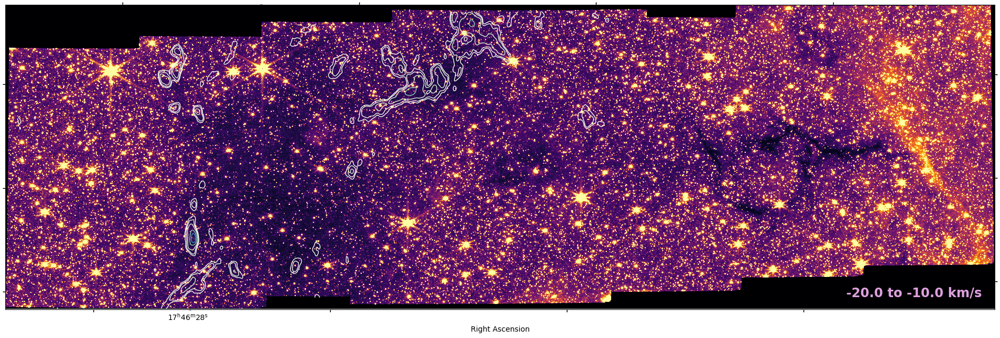

In [128]:
vlow = arr[0]
vhigh = arr[1]

mom0 = cube_HNCO.spectral_slab(vlow, vhigh).moment0()

plt.figure(figsize=(24,10))
ax = plt.subplot(111, projection=rgb_wcs)#, origin='lower')
ax.imshow(rgb, vmin=0, vmax=50, cmap='inferno')
ax.contour(mom0.data, transform=ax.get_transform(mom0.wcs), 
           #levels=get_percentile_list(cutout_radio.data), 
           #levels=get_step_list(cutout_radio.data),
           levels=get_mean_sigma_list(mom0.data, sigma_list=sigma_list),
           #colors='yellow', 
           cmap='GnBu',
           linewidths=1.)
ax.text(x=6800, y=100, s=f"{vlow.value} to {vhigh.value} km/s", color='plum', fontweight='bold', size='xx-large')

ax.set_ylabel('Declination')
ax.set_xlabel('Right Ascension')

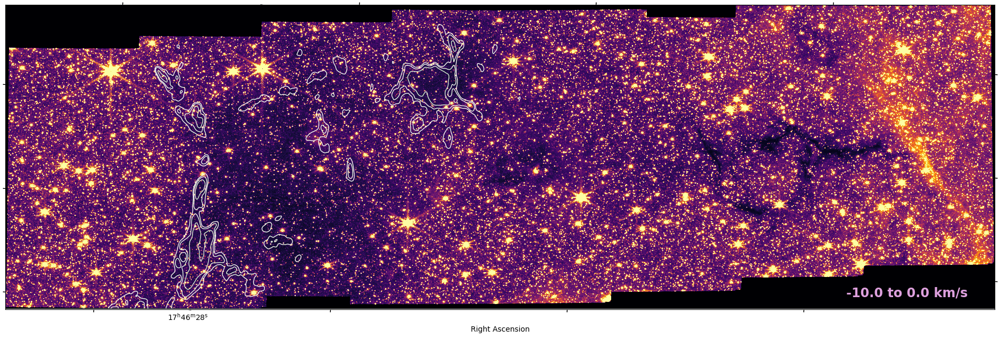

In [129]:
vlow = arr[1]
vhigh = arr[2]

mom0 = cube_HNCO.spectral_slab(vlow, vhigh).moment0()

plt.figure(figsize=(24,10))
ax = plt.subplot(111, projection=rgb_wcs)#, origin='lower')
ax.imshow(rgb, vmin=0, vmax=50, cmap='inferno')
ax.contour(mom0.data, transform=ax.get_transform(mom0.wcs), 
           #levels=get_percentile_list(cutout_radio.data), 
           #levels=get_step_list(cutout_radio.data),
           levels=get_mean_sigma_list(mom0.data, sigma_list=sigma_list),
           #colors='yellow', 
           cmap='GnBu',
           linewidths=1.)
ax.text(x=6800, y=100, s=f"{vlow.value} to {vhigh.value} km/s", color='plum', fontweight='bold', size='xx-large')

ax.set_ylabel('Declination')
ax.set_xlabel('Right Ascension')

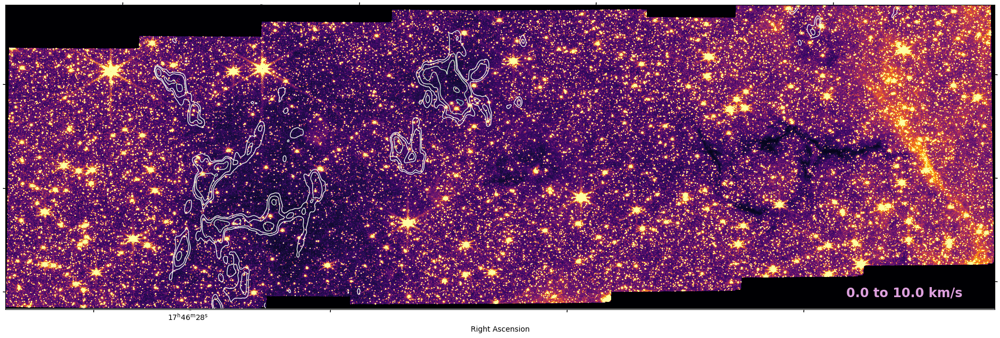

In [130]:
vlow = arr[2]
vhigh = arr[3]

mom0 = cube_HNCO.spectral_slab(vlow, vhigh).moment0()

plt.figure(figsize=(24,10))
ax = plt.subplot(111, projection=rgb_wcs)#, origin='lower')
ax.imshow(rgb, vmin=0, vmax=50, cmap='inferno')
ax.contour(mom0.data, transform=ax.get_transform(mom0.wcs), 
           #levels=get_percentile_list(cutout_radio.data), 
           #levels=get_step_list(cutout_radio.data),
           levels=get_mean_sigma_list(mom0.data, sigma_list=sigma_list),
           #colors='yellow', 
           cmap='GnBu',
           linewidths=1.)
ax.text(x=6800, y=100, s=f"{vlow.value} to {vhigh.value} km/s", color='plum', fontweight='bold', size='xx-large')

ax.set_ylabel('Declination')
ax.set_xlabel('Right Ascension')

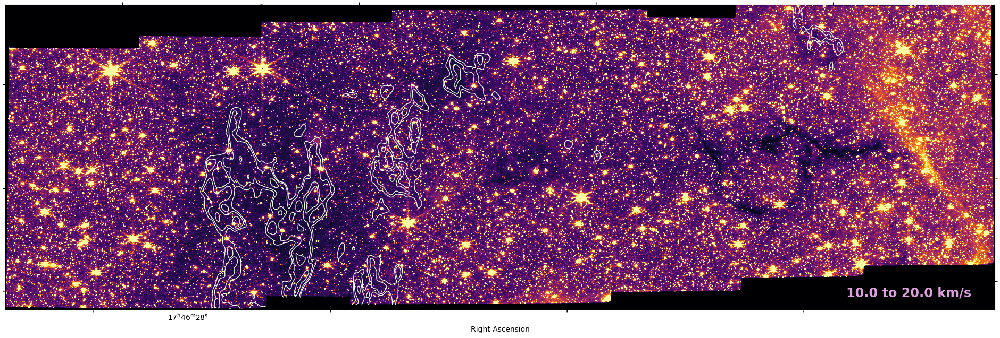

In [131]:
vlow = arr[3]
vhigh = arr[4]

mom0 = cube_HNCO.spectral_slab(vlow, vhigh).moment0()

plt.figure(figsize=(24,10))
ax = plt.subplot(111, projection=rgb_wcs)#, origin='lower')
ax.imshow(rgb, vmin=0, vmax=50, cmap='inferno')
ax.contour(mom0.data, transform=ax.get_transform(mom0.wcs), 
           #levels=get_percentile_list(cutout_radio.data), 
           #levels=get_step_list(cutout_radio.data),
           levels=get_mean_sigma_list(mom0.data, sigma_list=sigma_list),
           #colors='yellow', 
           cmap='GnBu',
           linewidths=1.)
ax.text(x=6800, y=100, s=f"{vlow.value} to {vhigh.value} km/s", color='plum', fontweight='bold', size='xx-large')

ax.set_ylabel('Declination')
ax.set_xlabel('Right Ascension')

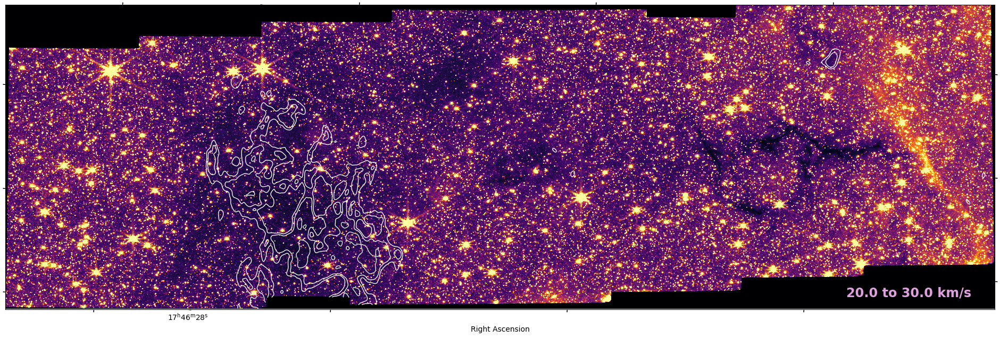

In [132]:
vlow = arr[4]
vhigh = arr[5]

mom0 = cube_HNCO.spectral_slab(vlow, vhigh).moment0()

plt.figure(figsize=(24,10))
ax = plt.subplot(111, projection=rgb_wcs)#, origin='lower')
ax.imshow(rgb, vmin=0, vmax=50, cmap='inferno')
ax.contour(mom0.data, transform=ax.get_transform(mom0.wcs), 
           #levels=get_percentile_list(cutout_radio.data), 
           #levels=get_step_list(cutout_radio.data),
           levels=get_mean_sigma_list(mom0.data, sigma_list=sigma_list),
           #colors='yellow', 
           cmap='GnBu',
           linewidths=1.)
ax.text(x=6800, y=100, s=f"{vlow.value} to {vhigh.value} km/s", color='plum', fontweight='bold', size='xx-large')

ax.set_ylabel('Declination')
ax.set_xlabel('Right Ascension')

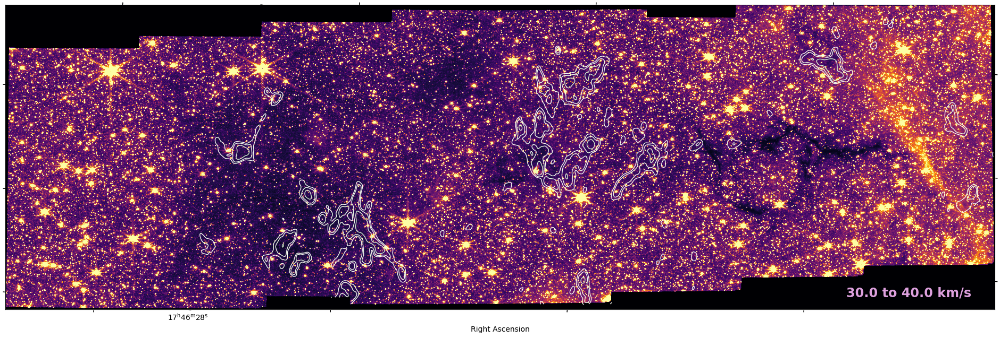

In [133]:
vlow = arr[5]
vhigh = arr[6]

mom0 = cube_HNCO.spectral_slab(vlow, vhigh).moment0()

plt.figure(figsize=(24,10))
ax = plt.subplot(111, projection=rgb_wcs)#, origin='lower')
ax.imshow(rgb, vmin=0, vmax=50, cmap='inferno')
ax.contour(mom0.data, transform=ax.get_transform(mom0.wcs), 
           #levels=get_percentile_list(cutout_radio.data), 
           #levels=get_step_list(cutout_radio.data),
           levels=get_mean_sigma_list(mom0.data, sigma_list=sigma_list),
           #colors='yellow', 
           cmap='GnBu',
           linewidths=1.)
ax.text(x=6800, y=100, s=f"{vlow.value} to {vhigh.value} km/s", color='plum', fontweight='bold', size='xx-large')

ax.set_ylabel('Declination')
ax.set_xlabel('Right Ascension')

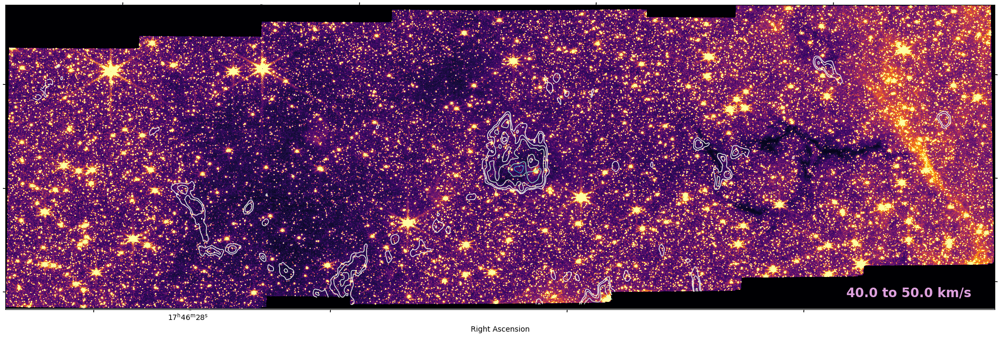

In [134]:
vlow = arr[6]
vhigh = arr[7]

mom0 = cube_HNCO.spectral_slab(vlow, vhigh).moment0()

plt.figure(figsize=(24,10))
ax = plt.subplot(111, projection=rgb_wcs)#, origin='lower')
ax.imshow(rgb, vmin=0, vmax=50, cmap='inferno')
ax.contour(mom0.data, transform=ax.get_transform(mom0.wcs), 
           #levels=get_percentile_list(cutout_radio.data), 
           #levels=get_step_list(cutout_radio.data),
           levels=get_mean_sigma_list(mom0.data, sigma_list=sigma_list),
           #colors='yellow', 
           cmap='GnBu',
           linewidths=1.)
ax.text(x=6800, y=100, s=f"{vlow.value} to {vhigh.value} km/s", color='plum', fontweight='bold', size='xx-large')

ax.set_ylabel('Declination')
ax.set_xlabel('Right Ascension')

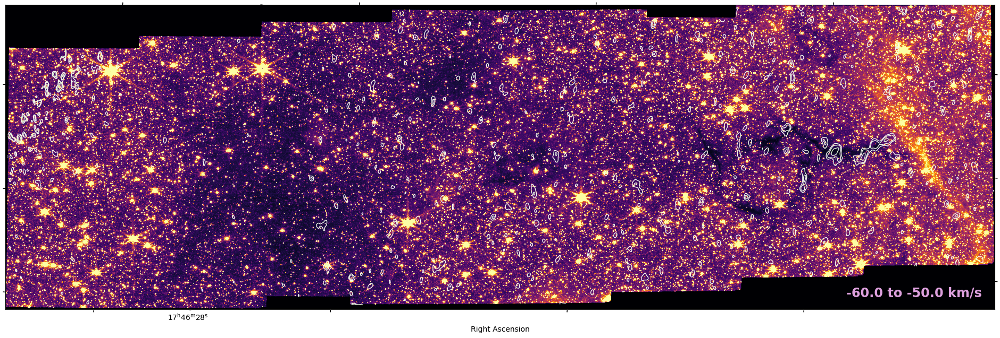

In [135]:
vlow = -60*u.km/u.s
vhigh = -50*u.km/u.s

mom0 = cube_HNCO.spectral_slab(vlow, vhigh).moment0()

plt.figure(figsize=(24,10))
ax = plt.subplot(111, projection=rgb_wcs)#, origin='lower')
ax.imshow(rgb, vmin=0, vmax=50, cmap='inferno')
ax.contour(mom0.data, transform=ax.get_transform(mom0.wcs), 
           #levels=get_percentile_list(cutout_radio.data), 
           #levels=get_step_list(cutout_radio.data),
           levels=get_mean_sigma_list(mom0.data, sigma_list=sigma_list),
           #colors='yellow', 
           cmap='GnBu',
           linewidths=1.)
ax.text(x=6800, y=100, s=f"{vlow.value} to {vhigh.value} km/s", color='plum', fontweight='bold', size='xx-large')

ax.set_ylabel('Declination')
ax.set_xlabel('Right Ascension')